# TRANSFER LEARNING


**Transfer Learning** adalah metode Machine Learning yang memungkinkan model-model yang telah dikembangkan untuk suatu tugas tertentu digunakan kembali sebagai titik awal untuk (membuat) model pada tugas-tugas lain yang serupa.


Tiga strategy Transfer Learning:
1. **Strategi 1** yang melatih ulang semua lapisan atau parameter pada jaringan
2. **Strategi 2** yang melatih sebagian lapisan pada jaringan, yaitu lapisan-lapisan pada bagian belakang dan lapisan FC/DNN.
3. **Strategi 3** yang melatih hanya bagian classifier atau lapisan FC/DNN saja.






## A. Pastikan Pengunaan GPU

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# Pastikan Anda menggunakan GPU dengan perintah berikut
!nvidia-smi

Sun Jun  9 22:40:29 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   55C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

## B. Unduh Dataset Food101 dengan 10 Label

In [3]:
from zipfile import ZipFile

landmark_file = '/content/drive/MyDrive/dataset.zip'
with ZipFile(landmark_file) as zip:
  zip.extractall()

In [4]:
# Lihat nama-nama direktori yang berisikan dataset
!ls Dataset

Test  Train


In [5]:
dir_path = 'Dataset/'
training_set_dir = dir_path + 'Train/'
test_set_dir = dir_path + 'Test/'



---


**Catatan Kode di bawah:**

`os.walk()` adalah fungsi untuk mengitari secara rekursif sebuah pohon direktori dan mengembalikan tuple yang terdiri dari 3 komponen, yaitu `dirpath`, `dirnames`, `filenames`, untuk setiap direktori di pohon.
*   `dirpath` adalah jalur ke direktori
*   `dirnames` adalah daftar nama subdirektori di direktori
* `filenames` adalah daftar nama file di direktori

In [6]:
import os

# Mari kita lihat jumlah example pada training set dan test set
for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"Terdapat {len(dirnames)} direktori and {len(filenames)} file gambar di '{dirpath}'.")

Terdapat 2 direktori and 0 file gambar di 'Dataset/'.
Terdapat 25 direktori and 0 file gambar di 'Dataset/Test'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Benteng Vredenburg'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Tugu Katulistiwa'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Candi Prambanan'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Masjid Istiqlal'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Monumen Nol Kilometer Indonesia'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Istana Maimun'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Tugu Pahlawan Surabaya'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/GWK Bali'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Kota Tua'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Keong Mas'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Keraton Jogja'.
Terdapat 0 direktori and 10 file gambar di 'Dataset/Test/Ma

## C. Buat Training dan Test Set

**Catatan kode di bawah:**

`image_dataset_from_directory()` adalah fungsi TensorFlow yang digunakan untuk membuat dataset gambar dari direktori.

In [7]:
# import fungsi untuk penyiapan dataset dalam format TensorFlow
from tensorflow.keras.preprocessing import image_dataset_from_directory

# ukuran gambar input yang akan diproses (tinggi, lebar)
# jika ukuran berbeda maka akan dibuat menjadi ukuran ini
IMAGE_SIZE = (224, 224)

# ukuran batch (jumlah gambar perbatch) yang akan dibuat
# jika gunakan nilai default = 32
# maka batch yang terdiri dari 32 gambar akan dikirimkan ke model pada setiap putaran
BATCH_SIZE = 32

# Penyiapan training set
# Lihat buku untuk penjelasan setiap parameter
training_set = image_dataset_from_directory(directory=training_set_dir,
                                            image_size=IMAGE_SIZE,
                                            label_mode='categorical',
                                            batch_size=BATCH_SIZE,
                                            validation_split=0.25,
                                            subset='training',
                                            seed=62024)

# Penyiapan validation set (25% dari training set)
validation_set = image_dataset_from_directory(directory=training_set_dir,
                                            image_size=IMAGE_SIZE,
                                            label_mode='categorical',
                                            batch_size=BATCH_SIZE,
                                            validation_split=0.25,
                                            subset='validation',
                                            seed=62024)

# Penyiapan test set
test_set = image_dataset_from_directory(directory=test_set_dir,
                                        image_size=IMAGE_SIZE,
                                        label_mode='categorical')

Found 1041 files belonging to 25 classes.
Using 781 files for training.
Found 1041 files belonging to 25 classes.
Using 260 files for validation.
Found 250 files belonging to 25 classes.


In [8]:
# lihat 25 nama kategori landmark pada dataset
training_set.class_names

['Benteng Vredenburg',
 'Candi Borobudur',
 'Candi Prambanan',
 'GWK Bali',
 'Gedung Sate',
 'Istana Maimun',
 'Jam Gadang',
 'Keong Mas',
 'Keraton Jogja',
 'Kota Tua',
 'Lawang Sewu',
 'Masjid Istiqlal',
 'Masjid Menara Kudus',
 'Masjid Raya Baiturrahman',
 'Menara Siger Lampung',
 'Monas',
 'Monumen Bandung Lautan Api',
 'Monumen Gong Perdamaian',
 'Monumen Nol Kilometer Indonesia',
 'Monumen Simpang Lima Gumul',
 'Patung Ikan Sura dan Baya',
 'Patung Yesus Memberkati',
 'Tugu Jogja',
 'Tugu Katulistiwa',
 'Tugu Pahlawan Surabaya']



---


**Catatan untuk output di bawah ini:**
* `(None, Image_size, Image_size, 3)` mengacu pada bentuk tensor dari gambar kita, di mana `None` adalah ukuran batch, `150` adalah tinggi dan lebar gambar serta `3` adalah jumlah saluran warna (merah, hijau, biru)
* Baik tensor gambar dan label memiliki tipe data `tf.float32`
* Nilai `batch_size `adalah `None` karena hanya digunakan selama pelatihan model. Anda dapat menganggap `None` sebagai placeholder yang menunggu untuk diisi dengan parameter `batch_size` dari fungsi `image_dataset_from_directory()` saat model dilatih
* Penggunaan nilai placeholder `None` untuk `batch_size` memiliki beberapa keuntungan:

  1. Memungkinkan untuk menentukan nilai `batch_size` secara dinamis saat model dilatih
  2. Memungkinkan untuk menggunakan nilai `batch_size` yang berbeda untuk berbagai tahap pelatihan model




In [9]:
# (None, 224, 224, 3) refers to the tensor shape of our images where None is the batch size, 224 is the height (and width) and 3 is the color channels (red, green, blue).
# (None, 10) refers to the tensor shape of the labels where None is the batch size and 10 is the number of possible labels (the 10 different food classes).
# Both image tensors and labels are of the datatype tf.float32.
# The batch_size is None due to it only being used during model training. You can think of None as a placeholder waiting to be filled with the batch_size parameter from image_dataset_from_directory().

training_set

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 25), dtype=tf.float32, name=None))>



---


**Catatan: eksperimen dimulai dari Strategi 3 diikuti oleh Strategi 2 dan Strategi 1.**

## D. Strategi 3: Hanya Mengubah Output Layer

In [10]:
import tensorflow as tf

tf.random.set_seed(62024)

#-------------
# Mari kita buat model dengan metode Transfer Learning
#------------

#1 Pilih dan unduh pretrained model
pretrained_model = tf.keras.applications.EfficientNetV2B0(weights='imagenet',
                                                        include_top=False,
                                                        pooling='avg')

#2 Buat agar paramater model tidak bisa diubah (frozen)
pretrained_model.trainable=False

24274472/24274472 [==============================] - 0s 0us/step


In [11]:
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import Model

# Buat Input baru karena kita menggunakan training set sendiri yang berbeda dengan ImageNet
inputs = Input(shape=(224,224,3), name='input_layer')

# Berikan Input layer baru sebagai input pada pretrained-model
revised_model_3 = pretrained_model(inputs)

# Definisikan output layer baru (karena kita menggunakan strategi 3)
outputs = Dense(25, activation='softmax', name='output_layer')(revised_model_3)

# Buat Model dengan menghubungkan antara inputs dan outputs
model_3 = Model(inputs, outputs, name='model_3')

In [12]:
# Mari kita compile model_3 agar siap dilakukan
# pelatihan untuk parameter jaringan (bagian output saja pada kasus ini)
model_3.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics='accuracy')

In [13]:
# lihat struktur dan parameter model
model_3.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Functio  (None, 1280)              5919312   
 nal)                                                            
                                                                 
 output_layer (Dense)        (None, 25)                32025     
                                                                 
Total params: 5951337 (22.70 MB)
Trainable params: 32025 (125.10 KB)
Non-trainable params: 5919312 (22.58 MB)
_________________________________________________________________


**Catatan kode di bawah ini:**

Perintah `%load_ext tensorboard` adalah perintah Jupyter yang memuat ekstensi TensorBoard ke notebook saat ini. Ekstensi ini memungkinkan Anda untuk memvisualisasi pelatihan dan evaluasi model pembelajaran mesin Anda menggunakan TensorBoard.

In [14]:
from tensorflow.keras.callbacks import TensorBoard
import datetime

# hapus log tensorboard dari hasil eksekusi sebelumnya jika ada
!rm -rf /logs/fit/

# load tensorboard dengan magic command Jupyter
%load_ext tensorboard

# tetapkan direktori penyimpanan data hasil tangkapan
log_folder = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

# buat callback tensorboard
tb_callbacks = TensorBoard(log_dir=log_folder)

In [15]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# buat EarlyStopping callback
es_callback = EarlyStopping(monitor='val_loss', patience=5, verbose=1)

# buat ModelCheckpoint callback
mpt_callback= ModelCheckpoint(filepath='best_model_3.h5', save_best_only=True, verbose=1)


In [16]:
# Sekarang kita latih model_3 untuk mendapatkan parameter pada output layer
# Wow, kita mendapat akurasi 83%! dengan menggunakan strategi 3
tf.random.set_seed(62024)

import time
start = time.perf_counter()

model_3.fit(training_set,
            epochs=100,
            validation_data=validation_set,
            callbacks = [tb_callbacks, es_callback, mpt_callback])

elapsed = time.perf_counter() - start

Epoch 1/100
25/25 [==============================] - ETA: 0s - loss: 2.4474 - accuracy: 0.4648
Epoch 1: val_loss improved from inf to 1.63394, saving model to best_model_3.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


25/25 [==============================] - 27s 515ms/step - loss: 2.4474 - accuracy: 0.4648 - val_loss: 1.6339 - val_accuracy: 0.8000
Epoch 2/100
24/25 [===========================>..] - ETA: 0s - loss: 1.0576 - accuracy: 0.9323
Epoch 2: val_loss improved from 1.63394 to 0.83892, saving model to best_model_3.h5
25/25 [==============================] - 7s 227ms/step - loss: 1.0522 - accuracy: 0.9321 - val_loss: 0.8389 - val_accuracy: 0.9231
Epoch 3/100
24/25 [===========================>..] - ETA: 0s - loss: 0.5363 - accuracy: 0.9779
Epoch 3: val_loss improved from 0.83892 to 0.54576, saving model to best_model_3.h5
25/25 [==============================] - 8s 295ms/step - loss: 0.5342 - accuracy: 0.9782 - val_loss: 0.5458 - val_accuracy: 0.9423
Epoch 4/100
24/25 [===========================>..] - ETA: 0s - loss: 0.3413 - accuracy: 0.9857
Epoch 4: val_loss improved from 0.54576 to 0.41604, saving model to best_model_3.h5
25/25 [==============================] - 8s 267ms/step - loss: 0.3402

In [17]:
print('Elapsed %.3f seconds.' % elapsed)

Elapsed 661.127 seconds.


In [18]:
# Harap sabar: tensorboard memerlukan waktu untuk tayang
%tensorboard --logdir={log_folder}

<IPython.core.display.Javascript object>

In [19]:
from tensorflow.keras.models import load_model

# Load best hyperparameters dari hasil pembelajaran model yang telah dilakukan
best_model_3 = load_model('best_model_3.h5')

# Lakukan evaluasi kinerja model dengan test set
best_model_3.evaluate(test_set)

8/8 [==============================] - 5s 273ms/step - loss: 0.0567 - accuracy: 0.9840


[0.056725870817899704, 0.984000027179718]

## E. Strategi 2: Trainable hanya beberapa Layer Terakhir

In [20]:
# Set pretrained_model agar parameter jaringan bisa dilatih
pretrained_model.trainable=True

In [21]:
# Perhatikan bahwa semua layer pada pretrained model telah di frozen!
for urutan, lapisan in enumerate(pretrained_model.layers):
  print(urutan, lapisan.name, lapisan.trainable)

0 input_1 True
1 rescaling True
2 normalization True
3 stem_conv True
4 stem_bn True
5 stem_activation True
6 block1a_project_conv True
7 block1a_project_bn True
8 block1a_project_activation True
9 block2a_expand_conv True
10 block2a_expand_bn True
11 block2a_expand_activation True
12 block2a_project_conv True
13 block2a_project_bn True
14 block2b_expand_conv True
15 block2b_expand_bn True
16 block2b_expand_activation True
17 block2b_project_conv True
18 block2b_project_bn True
19 block2b_drop True
20 block2b_add True
21 block3a_expand_conv True
22 block3a_expand_bn True
23 block3a_expand_activation True
24 block3a_project_conv True
25 block3a_project_bn True
26 block3b_expand_conv True
27 block3b_expand_bn True
28 block3b_expand_activation True
29 block3b_project_conv True
30 block3b_project_bn True
31 block3b_drop True
32 block3b_add True
33 block4a_expand_conv True
34 block4a_expand_bn True
35 block4a_expand_activation True
36 block4a_dwconv2 True
37 block4a_bn True
38 block4a_activ

In [22]:
# sekarang kita unfrozen 35 layer pada bagian belakang lapisan convolution
for urutan, lapisan in enumerate(pretrained_model.layers[:-35]):
  lapisan.trainable=False
  print(urutan, lapisan.name, lapisan.trainable)

0 input_1 False
1 rescaling False
2 normalization False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_drop False
20 block2b_add False
21 block3a_expand_conv False
22 block3a_expand_bn False
23 block3a_expand_activation False
24 block3a_project_conv False
25 block3a_project_bn False
26 block3b_expand_conv False
27 block3b_expand_bn False
28 block3b_expand_activation False
29 block3b_project_conv False
30 block3b_project_bn False
31 block3b_drop False
32 block3b_add False
33 block4a_expand_conv False
34 block4a_expand_bn False
35 block4a_expand_activation False
36 block4a_dwconv2 Fals

In [23]:
# Berikan input layer sebagai input pada pretrained-model
revised_model_2 = pretrained_model(inputs)

# Definisikan output layer (strategi 2)
outputs = Dense(25, activation='softmax', name='output_layer')(revised_model_2)

# defisinikan model dengan strategi 3 dengan me-link inputs dan outputs
model_2 = Model(inputs, outputs, name='model_2')

In [24]:
# Mari kita compile model_2 agar siap dilakukan pelatihan untuk parameter jaringan
model_2.compile(loss='categorical_crossentropy',
                optimizer=tf.keras.optimizers.Adam(), #learning_rate=0.0001
                metrics='accuracy')

In [25]:
model_2.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Functio  (None, 1280)              5919312   
 nal)                                                            
                                                                 
 output_layer (Dense)        (None, 25)                32025     
                                                                 
Total params: 5951337 (22.70 MB)
Trainable params: 1419385 (5.41 MB)
Non-trainable params: 4531952 (17.29 MB)
_________________________________________________________________


In [26]:
log_folder = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

tb_callbacks = TensorBoard(log_dir=log_folder)

In [27]:
mpt_callback= ModelCheckpoint(filepath='best_model_2.h5', save_best_only=True, verbose=1)

In [28]:
# Sekarang kita latih model_2 untuk mendapatkan parameter pada output layer

tf.random.set_seed(62024)

start = time.perf_counter()

model_2.fit(training_set,
            epochs=100,
            validation_data=validation_set,
            callbacks = [tb_callbacks, es_callback, mpt_callback])

elapsed = time.perf_counter() - start

Epoch 1/100
24/25 [===========================>..] - ETA: 0s - loss: 1.3866 - accuracy: 0.7370
Epoch 1: val_loss improved from inf to 0.19432, saving model to best_model_2.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


25/25 [==============================] - 26s 453ms/step - loss: 1.3675 - accuracy: 0.7414 - val_loss: 0.1943 - val_accuracy: 0.9577
Epoch 2/100
24/25 [===========================>..] - ETA: 0s - loss: 0.1225 - accuracy: 0.9831
Epoch 2: val_loss improved from 0.19432 to 0.11446, saving model to best_model_2.h5
25/25 [==============================] - 7s 235ms/step - loss: 0.1214 - accuracy: 0.9834 - val_loss: 0.1145 - val_accuracy: 0.9731
Epoch 3/100
24/25 [===========================>..] - ETA: 0s - loss: 0.0404 - accuracy: 0.9974
Epoch 3: val_loss improved from 0.11446 to 0.08643, saving model to best_model_2.h5
25/25 [==============================] - 11s 395ms/step - loss: 0.0404 - accuracy: 0.9974 - val_loss: 0.0864 - val_accuracy: 0.9808
Epoch 4/100
24/25 [===========================>..] - ETA: 0s - loss: 0.0233 - accuracy: 0.9987
Epoch 4: val_loss improved from 0.08643 to 0.07210, saving model to best_model_2.h5
25/25 [==============================] - 7s 238ms/step - loss: 0.023

In [29]:
print('Elapsed %.3f seconds.' % elapsed)

Elapsed 138.720 seconds.


In [30]:
# Gunakan port berbeda (8008) untuk tayangkan tensorboard Strategi 2
%tensorboard --logdir={log_folder} --port=8008

<IPython.core.display.Javascript object>

In [31]:
# Load best hyperparameters from previous fit process
best_model_2 = load_model('best_model_2.h5')

# Let's evaluate the model
best_model_2.evaluate(test_set)

8/8 [==============================] - 4s 67ms/step - loss: 0.0451 - accuracy: 0.9920


[0.04506219923496246, 0.9919999837875366]

In [32]:
class_names = test_set.class_names
class_names

['Benteng Vredenburg',
 'Candi Borobudur',
 'Candi Prambanan',
 'GWK Bali',
 'Gedung Sate',
 'Istana Maimun',
 'Jam Gadang',
 'Keong Mas',
 'Keraton Jogja',
 'Kota Tua',
 'Lawang Sewu',
 'Masjid Istiqlal',
 'Masjid Menara Kudus',
 'Masjid Raya Baiturrahman',
 'Menara Siger Lampung',
 'Monas',
 'Monumen Bandung Lautan Api',
 'Monumen Gong Perdamaian',
 'Monumen Nol Kilometer Indonesia',
 'Monumen Simpang Lima Gumul',
 'Patung Ikan Sura dan Baya',
 'Patung Yesus Memberkati',
 'Tugu Jogja',
 'Tugu Katulistiwa',
 'Tugu Pahlawan Surabaya']

## F. Strategi 1: Seluruh Paramater Dilatih

In [33]:
# Set pretrained_model agar parameter jaringan bisa dilatih
pretrained_model.trainable=True

In [34]:
# Perhatikan bahwa semua layer pada pretrained model telah di frozen!
for urutan, lapisan in enumerate(pretrained_model.layers):
  print(urutan, lapisan.name, lapisan.trainable)

0 input_1 True
1 rescaling True
2 normalization True
3 stem_conv True
4 stem_bn True
5 stem_activation True
6 block1a_project_conv True
7 block1a_project_bn True
8 block1a_project_activation True
9 block2a_expand_conv True
10 block2a_expand_bn True
11 block2a_expand_activation True
12 block2a_project_conv True
13 block2a_project_bn True
14 block2b_expand_conv True
15 block2b_expand_bn True
16 block2b_expand_activation True
17 block2b_project_conv True
18 block2b_project_bn True
19 block2b_drop True
20 block2b_add True
21 block3a_expand_conv True
22 block3a_expand_bn True
23 block3a_expand_activation True
24 block3a_project_conv True
25 block3a_project_bn True
26 block3b_expand_conv True
27 block3b_expand_bn True
28 block3b_expand_activation True
29 block3b_project_conv True
30 block3b_project_bn True
31 block3b_drop True
32 block3b_add True
33 block4a_expand_conv True
34 block4a_expand_bn True
35 block4a_expand_activation True
36 block4a_dwconv2 True
37 block4a_bn True
38 block4a_activ

In [35]:
# Berikan input layer sebagai input pada pretrained-model
revised_model_1 = pretrained_model(inputs)

# Definisikan output layer (strategi 1)
outputs = Dense(25, activation='softmax', name='output_layer')(revised_model_1)

# defisinikan model dengan strategi 3 dengan me-link inputs dan outputs
model_1 = Model(inputs, outputs, name='model_1')

In [36]:
# Mari kita compile model_1 agar siap dilakukan pelatihan untuk parameter jaringan
model_1.compile(loss='categorical_crossentropy',
                optimizer=tf.keras.optimizers.Adam(), #learning_rate=0.0001
                metrics='accuracy')

In [37]:
model_1.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Functio  (None, 1280)              5919312   
 nal)                                                            
                                                                 
 output_layer (Dense)        (None, 25)                32025     
                                                                 
Total params: 5951337 (22.70 MB)
Trainable params: 5890729 (22.47 MB)
Non-trainable params: 60608 (236.75 KB)
_________________________________________________________________


In [38]:
log_folder = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

tb_callbacks = TensorBoard(log_dir=log_folder)

In [39]:
mpt_callback= ModelCheckpoint(filepath='best_model_1.h5', save_best_only=True, verbose=1)

In [40]:
# Sekarang kita latih model_1 untuk mendapatkan parameter pada output layer

tf.random.set_seed(62024)

start = time.perf_counter()

model_1.fit(training_set,
            epochs=100,
            validation_data=validation_set,
            callbacks = [tb_callbacks, mpt_callback, es_callback])

elapsed = time.perf_counter() - start

Epoch 1/100
25/25 [==============================] - ETA: 0s - loss: 0.9869 - accuracy: 0.8067
Epoch 1: val_loss improved from inf to 0.11697, saving model to best_model_1.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


25/25 [==============================] - 63s 479ms/step - loss: 0.9869 - accuracy: 0.8067 - val_loss: 0.1170 - val_accuracy: 0.9692
Epoch 2/100
25/25 [==============================] - ETA: 0s - loss: 0.0725 - accuracy: 0.9821
Epoch 2: val_loss did not improve from 0.11697
25/25 [==============================] - 10s 347ms/step - loss: 0.0725 - accuracy: 0.9821 - val_loss: 0.1476 - val_accuracy: 0.9538
Epoch 3/100
25/25 [==============================] - ETA: 0s - loss: 0.0582 - accuracy: 0.9872
Epoch 3: val_loss did not improve from 0.11697
25/25 [==============================] - 13s 413ms/step - loss: 0.0582 - accuracy: 0.9872 - val_loss: 0.1318 - val_accuracy: 0.9692
Epoch 4/100
25/25 [==============================] - ETA: 0s - loss: 0.0705 - accuracy: 0.9808
Epoch 4: val_loss did not improve from 0.11697
25/25 [==============================] - 10s 357ms/step - loss: 0.0705 - accuracy: 0.9808 - val_loss: 0.1570 - val_accuracy: 0.9577
Epoch 5/100
25/25 [===========================

In [41]:
%tensorboard --logdir={log_folder} --port=8010

<IPython.core.display.Javascript object>

In [42]:
# Load best hyperparameters from previous fit process
best_model_1 = load_model('best_model_1.h5')

# Let's evaluate the model
best_model_1.evaluate(test_set)

8/8 [==============================] - 5s 63ms/step - loss: 0.0400 - accuracy: 0.9880


[0.04000384360551834, 0.9879999756813049]

## F. Klasifikasi Foto Makanan Aktual


In [ ]:
#def load_and_prep_image(filename, img_shape=224, scale=True):
#  """
#  Reads in an image from filename, turns it into a tensor and reshapes into
#  (224, 224, 3).

#  Parameters
##  ----------
#  filename (str): string filename of target image
 # img_shape (int): size to resize target image to, default 224
#  scale (bool): whether to scale pixel values to range(0, 1), default True
#  """
  # Read in the image
#  img = tf.io.read_file(filename)
  # Decode it into a tensor
#  img = tf.io.decode_image(img)
  # Resize the image
#  img = tf.image.resize(img, [img_shape, img_shape])
#  if scale:
    # Rescale the image (get all values between 0 and 1)
#    return img/255.
#  else:
#    return img

In [ ]:
#class_names = test_set.class_names
#class_names

In [43]:
import os
from zipfile import ZipFile

# Ambil dataset dan unzip data tersebut
!wget https://raw.githubusercontent.com/Raffa-R/dataset-capstone-collection/main/dataset_capstone_collection.zip

with ZipFile('dataset_capstone_collection.zip') as zip:
  zip.extractall()

--2024-06-09 23:03:52--  https://raw.githubusercontent.com/Raffa-R/dataset-capstone-collection/main/dataset_capstone_collection.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 986594 (963K) [application/zip]
Saving to: ‘dataset_capstone_collection.zip’

dataset_capstone_co 100%[===================>] 963.47K  --.-KB/s    in 0.04s   

2024-06-09 23:03:52 (22.0 MB/s) - ‘dataset_capstone_collection.zip’ saved [986594/986594]



In [44]:
# Buat list nama file berikut nama direktorinya
custom_food_images = ["dataset_capstone_collection/" + foto for foto in os.listdir("dataset_capstone_collection")]
custom_food_images

['dataset_capstone_collection/Baiturrahman_Mosque 1.jpg',
 'dataset_capstone_collection/tugu jogja.jpg',
 'dataset_capstone_collection/Jam_Gadang 1.jpg',
 'dataset_capstone_collection/Lawang_Sewu 1.jpg',
 'dataset_capstone_collection/Prambanan 1.jpg',
 'dataset_capstone_collection/Borobudur 1.jpg',
 'dataset_capstone_collection/menara_kudus 1.jpg',
 'dataset_capstone_collection/monas 1.jpg',
 'dataset_capstone_collection/istana_maimun 1.jpg',
 'dataset_capstone_collection/gedung sate.jpg']

In [45]:
# Load best hyperparameters from previous fit process
best_model_3 = load_model('best_model_3.h5')

1/1 [==============================] - 0s 33ms/step


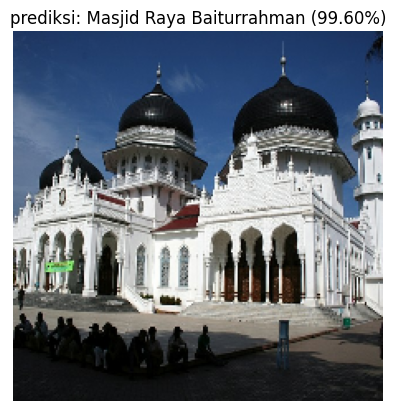

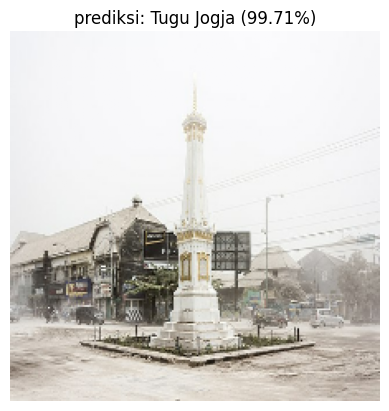

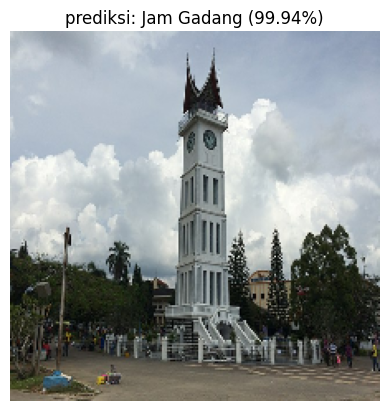

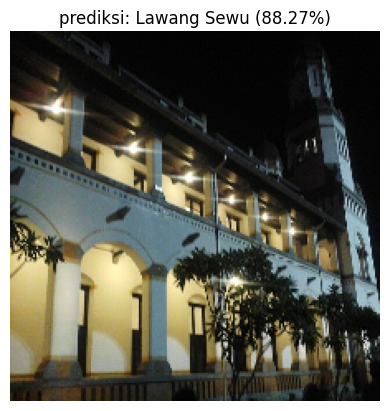

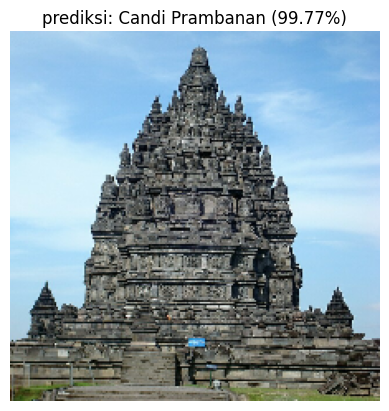

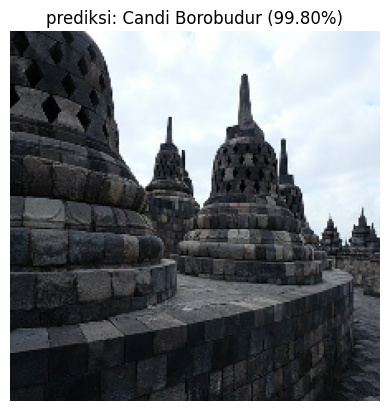

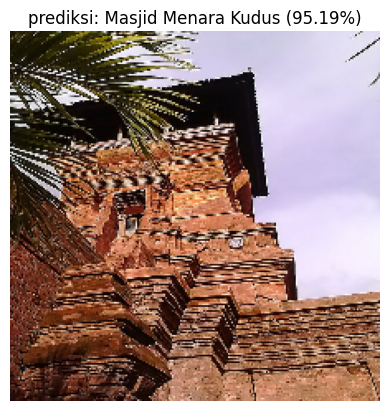

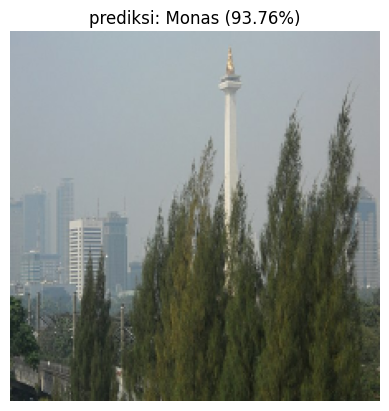

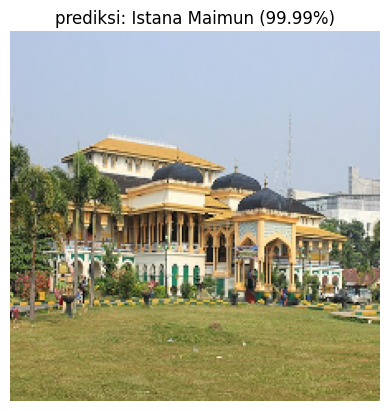

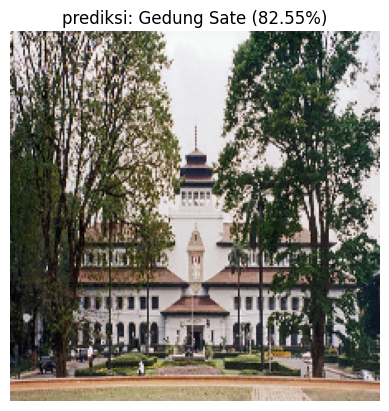

In [46]:
import matplotlib.pyplot as plt

# Make predictions on custom food images
for img in custom_food_images:

  # Read in the image
  img = tf.io.read_file(img)

  # Decode it into a tensor
  img = tf.io.decode_image(img)

  # Resize the image
  img = tf.image.resize(img, [224, 224])

  pred_prob = best_model_3.predict(tf.expand_dims(img, axis=0)) # make prediction on image with shape [None, 224, 224, 3]
  pred_catg = pred_prob.argmax(axis=-1)
  pred_class = class_names[pred_catg[0]] # find the predicted class label

  # Plot the image with appropriate annotations
  plt.figure()
  plt.imshow(img/255.) # imshow() requires float inputs to be normalized
  plt.title(f"prediksi: {pred_class} ({pred_prob.max()*100:.2f}%)")
  plt.axis(False)

In [47]:
# Load best hyperparameters from previous fit process
best_model_2 = load_model('best_model_2.h5')

1/1 [==============================] - 0s 122ms/step


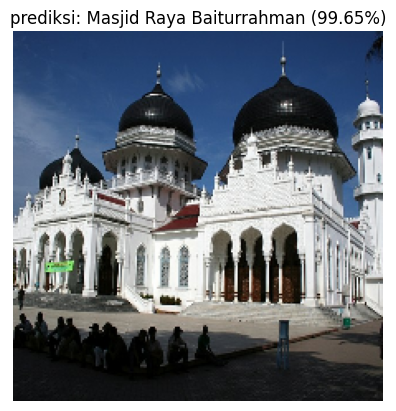

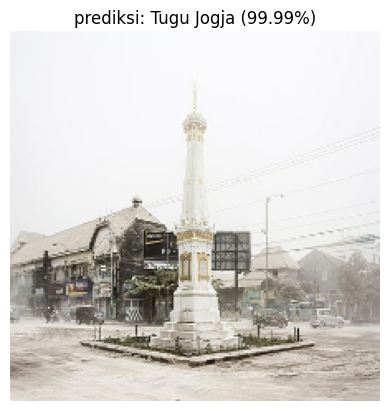

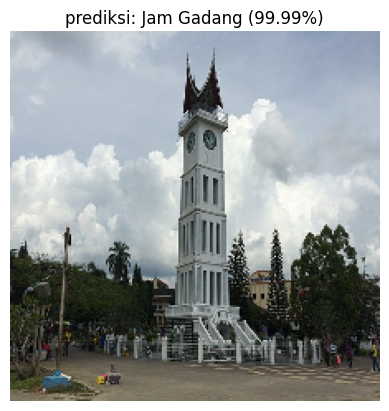

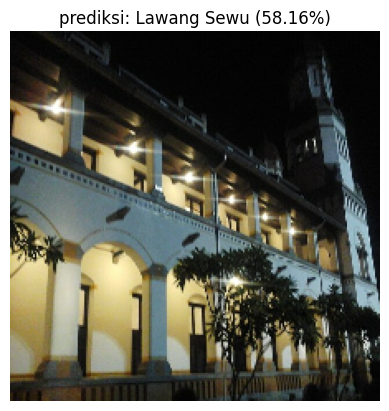

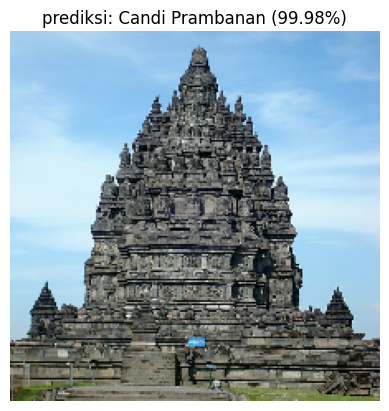

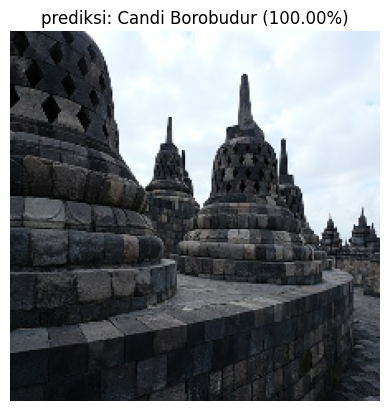

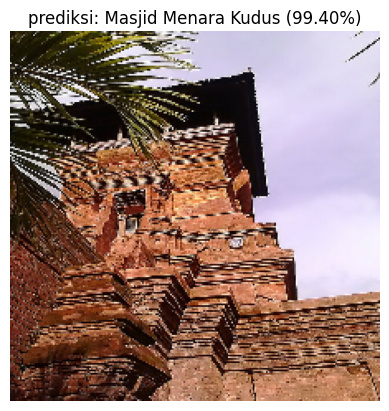

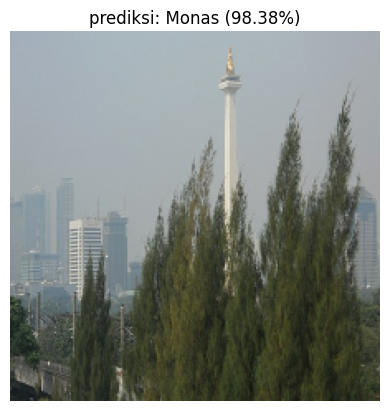

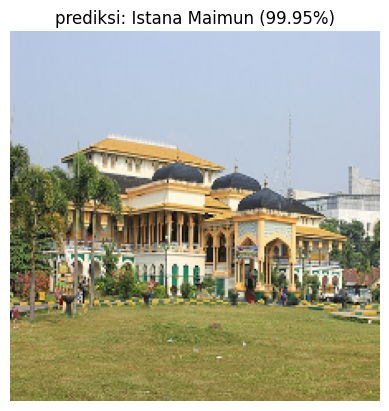

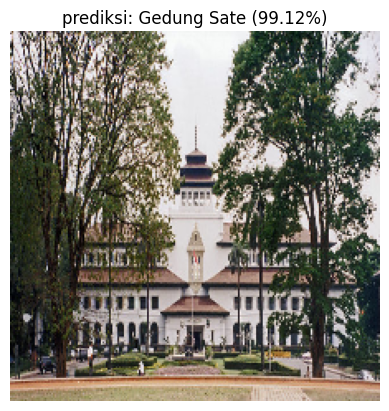

In [48]:
import matplotlib.pyplot as plt

# Make predictions on custom food images
for img in custom_food_images:

  # Read in the image
  img = tf.io.read_file(img)

  # Decode it into a tensor
  img = tf.io.decode_image(img)

  # Resize the image
  img = tf.image.resize(img, [224, 224])

  pred_prob = best_model_2.predict(tf.expand_dims(img, axis=0)) # make prediction on image with shape [None, 224, 224, 3]
  pred_catg = pred_prob.argmax(axis=-1)
  pred_class = class_names[pred_catg[0]] # find the predicted class label

  # Plot the image with appropriate annotations
  plt.figure()
  plt.imshow(img/255.) # imshow() requires float inputs to be normalized
  plt.title(f"prediksi: {pred_class} ({pred_prob.max()*100:.2f}%)")
  plt.axis(False)

In [49]:
# Load best hyperparameters from previous fit process
best_model_1 = load_model('best_model_1.h5')

1/1 [==============================] - 0s 32ms/step


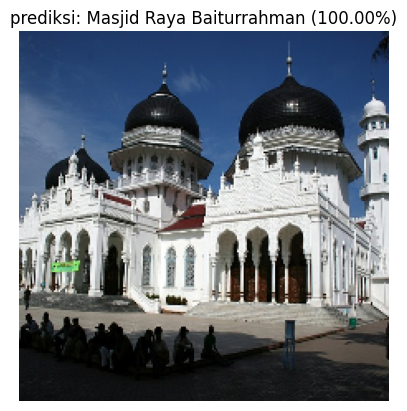

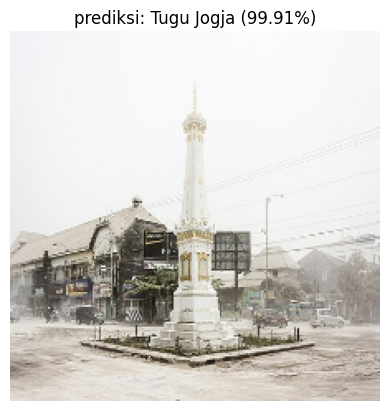

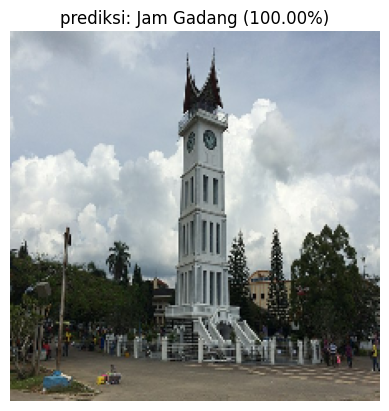

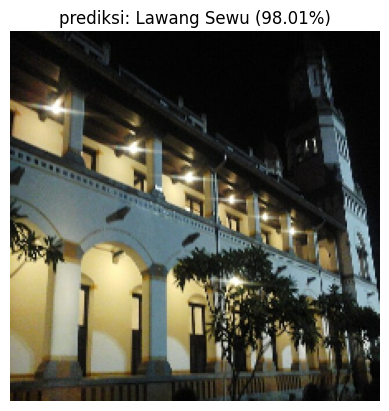

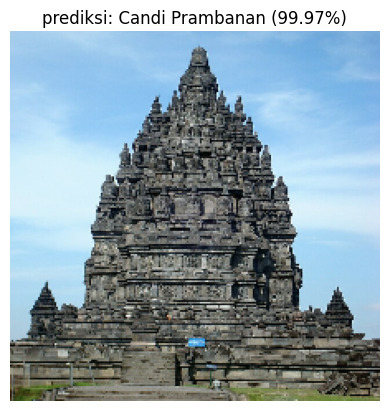

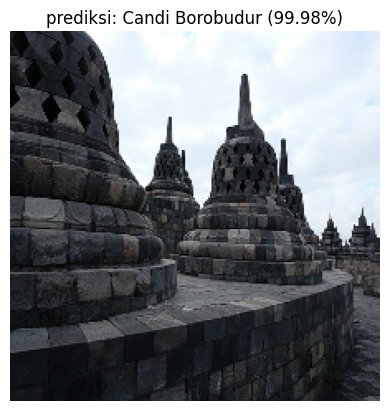

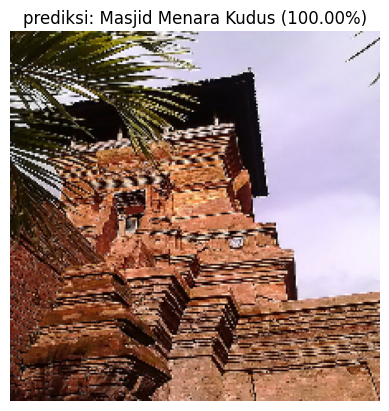

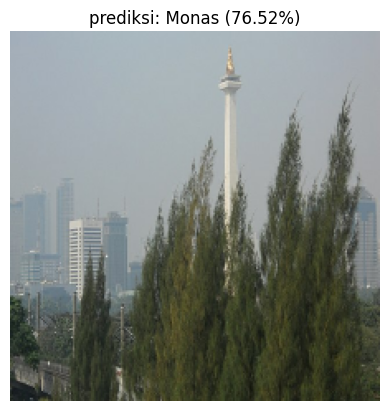

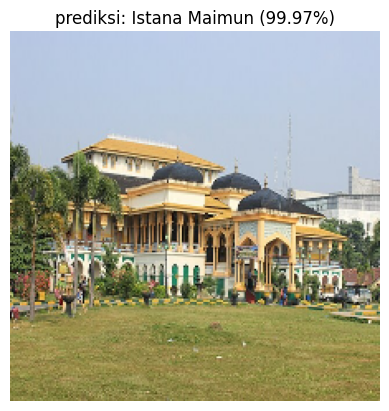

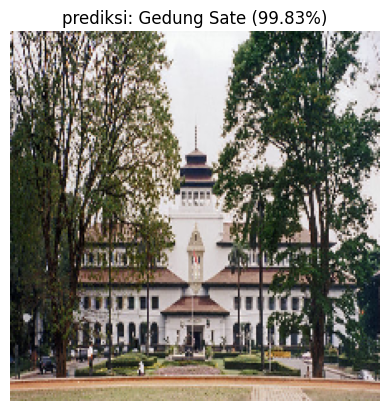

In [50]:
import matplotlib.pyplot as plt

# Make predictions on custom food images
for img in custom_food_images:

  # Read in the image
  img = tf.io.read_file(img)

  # Decode it into a tensor
  img = tf.io.decode_image(img)

  # Resize the image
  img = tf.image.resize(img, [224, 224])

  pred_prob = best_model_1.predict(tf.expand_dims(img, axis=0)) # make prediction on image with shape [None, 224, 224, 3]
  pred_catg = pred_prob.argmax(axis=-1)
  pred_class = class_names[pred_catg[0]] # find the predicted class label

  # Plot the image with appropriate annotations
  plt.figure()
  plt.imshow(img/255.) # imshow() requires float inputs to be normalized
  plt.title(f"prediksi: {pred_class} ({pred_prob.max()*100:.2f}%)")
  plt.axis(False)